In [85]:
import geopandas as gpd
import esda
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from libpysal import graph

In [86]:
gdf = gpd.read_parquet('/data/processed_data/fbg_ntn.parquet')

In [87]:
gdf['% German']=gdf['% German']*100

remove nan values to calculate Moran's I

In [88]:
not_nan = ~np.isnan(gdf['% German'])

In [89]:
not_nan

ID
100mN27599E41570    True
100mN27599E41571    True
100mN27599E41572    True
100mN27599E41573    True
100mN27599E41574    True
                    ... 
100mN27800E41631    True
100mN27800E41632    True
100mN27800E41633    True
100mN27800E41634    True
100mN27800E41635    True
Name: % German, Length: 6965, dtype: bool

In [90]:
gdf = gdf[not_nan]

In [91]:
gdf

Category,Germany,Abroad,geometry,% German
ID,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571
...,...,...,...,...
100mN27800E41631,6.0,NaN,"POLYGON ((4163200 2780100, 4163200 2780000, 41...",100.000000
100mN27800E41632,42.0,NaN,"POLYGON ((4163300 2780100, 4163300 2780000, 41...",100.000000
100mN27800E41633,37.0,NaN,"POLYGON ((4163400 2780100, 4163400 2780000, 41...",100.000000


In [92]:
gdf.explore(
    "% German",
    cmap="coolwarm",
    vmin=0,
    vmax=100,
    prefer_canvas=True,
    tiles="CartoDB Positron",
)

<Axes: >

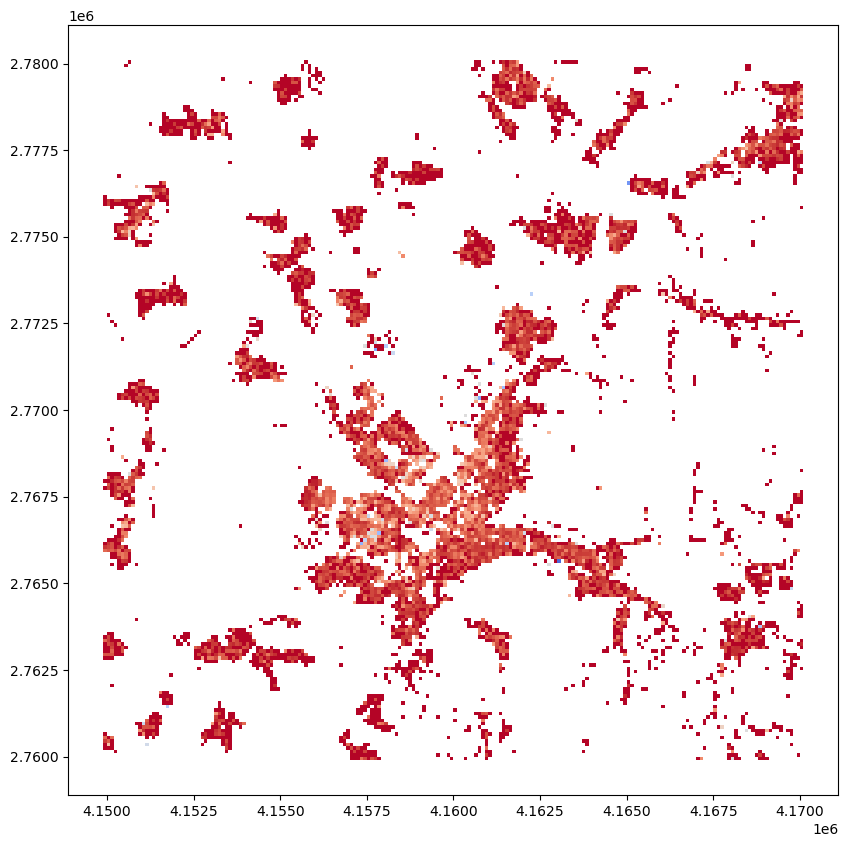

In [93]:
f, ax = plt.subplots(1, figsize=(10, 10))
gdf.plot(ax=ax, column = "% German",cmap="coolwarm",vmin=0,vmax=100)

In [94]:
contiguity = graph.Graph.build_contiguity(gdf, rook=False)

In [95]:
contiguity

<Graph of 6909 nodes and 39474 nonzero edges indexed by
 ['100mN27599E41570', '100mN27599E41571', '100mN27599E41572', '100mN27599E41573', '100mN27599E41574', ...]>

In [96]:
contiguity['100mN27599E41570']

neighbor
100mN27599E41571    1
100mN27600E41570    1
100mN27600E41571    1
Name: weight, dtype: int64

In [97]:
contiguity_r = contiguity.transform("r")

In [98]:
contiguity_r['100mN27599E41570']

neighbor
100mN27599E41571    0.333333
100mN27600E41570    0.333333
100mN27600E41571    0.333333
Name: weight, dtype: float64

In [99]:
gdf['lag'] = contiguity_r.lag(gdf["% German"])
gdf.head()

Category,Germany,Abroad,geometry,% German,lag
ID,,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000,100.000000
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000,100.000000
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000,96.744186
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930,98.285714
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571,96.744186


In [100]:
gdf["%G_std"] = (
    gdf["% German"] - gdf["% German"].mean()
) / gdf["% German"].std()

In [101]:
gdf

Category,Germany,Abroad,geometry,% German,lag,%G_std
ID,,,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000,100.000000,0.669586
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000,100.000000,0.669586
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000,96.744186,0.669586
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930,98.285714,-1.003532
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571,96.744186,-0.211362
...,...,...,...,...,...,...
100mN27800E41631,6.0,NaN,"POLYGON ((4163200 2780100, 4163200 2780000, 41...",100.000000,100.000000,0.669586
100mN27800E41632,42.0,NaN,"POLYGON ((4163300 2780100, 4163300 2780000, 41...",100.000000,100.000000,0.669586
100mN27800E41633,37.0,NaN,"POLYGON ((4163400 2780100, 4163400 2780000, 41...",100.000000,100.000000,0.669586


In [102]:
gdf["%G_std_lag"] = contiguity_r.lag(gdf["%G_std"])

In [103]:
gdf

Category,Germany,Abroad,geometry,% German,lag,%G_std,%G_std_lag
ID,,,,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000,100.000000,0.669586,0.669586
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000,100.000000,0.669586,0.669586
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000,96.744186,0.669586,0.334962
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930,98.285714,-1.003532,0.493396
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571,96.744186,-0.211362,0.334962
...,...,...,...,...,...,...,...
100mN27800E41631,6.0,NaN,"POLYGON ((4163200 2780100, 4163200 2780000, 41...",100.000000,100.000000,0.669586,0.669586
100mN27800E41632,42.0,NaN,"POLYGON ((4163300 2780100, 4163300 2780000, 41...",100.000000,100.000000,0.669586,0.669586
100mN27800E41633,37.0,NaN,"POLYGON ((4163400 2780100, 4163400 2780000, 41...",100.000000,100.000000,0.669586,0.669586


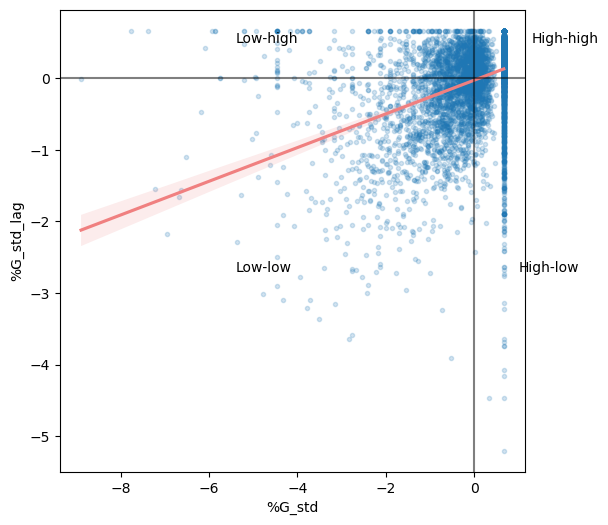

In [104]:
f, ax = plt.subplots(1, figsize=(6, 6))
sns.regplot(
    x="%G_std",
    y="%G_std_lag",
    data=gdf,
    marker=".",
    scatter_kws={"alpha": 0.2},
    line_kws=dict(color="lightcoral")
)
plt.axvline(0, c="black", alpha=0.5)
plt.axhline(0, c="black", alpha=0.5)
plt.text(1.3, .5, "High-high", fontsize=10)
plt.text(1, -2.7, "High-low", fontsize=10)
plt.text(-5.4, .5, "Low-high", fontsize=10)
plt.text(-5.4, -2.7, "Low-low", fontsize=10);

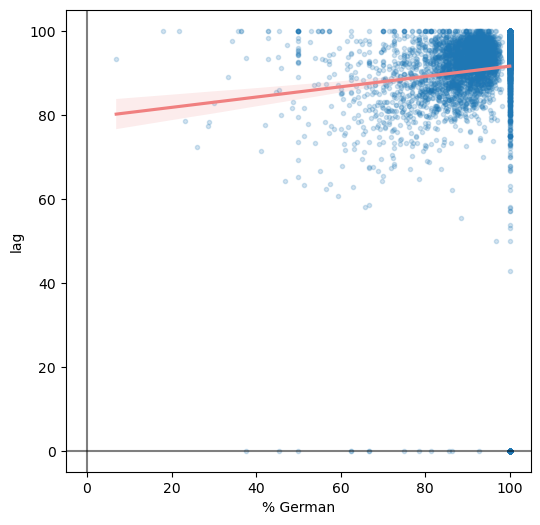

In [105]:
f, ax = plt.subplots(1, figsize=(6, 6))
sns.regplot(
    x="% German",
    y="lag",
    data=gdf,
    marker=".",
    scatter_kws={"alpha": 0.2},
    line_kws=dict(color="lightcoral")
)
plt.axvline(0, c="black", alpha=0.5)
plt.axhline(0, c="black", alpha=0.5);

In [106]:
mi = esda.Moran(gdf['% German'], contiguity_r.to_W())

('WARNING: ', '100mN27599E41603', ' is an island (no neighbors)')
('WARNING: ', '100mN27600E41595', ' is an island (no neighbors)')
('WARNING: ', '100mN27600E41699', ' is an island (no neighbors)')
('WARNING: ', '100mN27601E41617', ' is an island (no neighbors)')
('WARNING: ', '100mN27601E41637', ' is an island (no neighbors)')
('WARNING: ', '100mN27602E41672', ' is an island (no neighbors)')
('WARNING: ', '100mN27603E41511', ' is an island (no neighbors)')
('WARNING: ', '100mN27603E41697', ' is an island (no neighbors)')
('WARNING: ', '100mN27605E41598', ' is an island (no neighbors)')
('WARNING: ', '100mN27605E41677', ' is an island (no neighbors)')
('WARNING: ', '100mN27605E41693', ' is an island (no neighbors)')
('WARNING: ', '100mN27606E41583', ' is an island (no neighbors)')
('WARNING: ', '100mN27606E41670', ' is an island (no neighbors)')
('WARNING: ', '100mN27608E41666', ' is an island (no neighbors)')
('WARNING: ', '100mN27608E41668', ' is an island (no neighbors)')
('WARNING:

/opt/conda/lib/python3.11/site-packages/libpysal/graph/base.py:267: UserWarning: The weights matrix is not fully connected: 
 There are 349 disconnected components.
 There are 184 islands with ids: 100mN27599E41603, 100mN27600E41595, 100mN27600E41699, 100mN27601E41617, 100mN27601E41637, 100mN27602E41672, 100mN27603E41511, 100mN27603E41697, 100mN27605E41598, 100mN27605E41677, 100mN27605E41693, 100mN27606E41583, 100mN27606E41670, 100mN27608E41666, 100mN27608E41668, 100mN27610E41600, 100mN27610E41667, 100mN27611E41585, 100mN27611E41590, 100mN27611E41595, 100mN27611E41678, 100mN27612E41613, 100mN27613E41600, 100mN27614E41660, 100mN27615E41585, 100mN27615E41644, 100mN27616E41608, 100mN27617E41592, 100mN27617E41696, 100mN27619E41632, 100mN27620E41501, 100mN27620E41634, 100mN27621E41670, 100mN27622E41590, 100mN27623E41518, 100mN27623E41577, 100mN27623E41595, 100mN27624E41593, 100mN27624E41652, 100mN27624E41680, 100mN27625E41526, 100mN27625E41658, 100mN27625E41690, 100mN27625E41700, 100mN27626

In [107]:
mi.I

0.24197821483046592

In [108]:
print(f"Moran's I: {mi.I}, p-value: {mi.p_sim}")

Moran's I: 0.24197821483046592, p-value: 0.001


In [109]:
lisa = esda.Moran_Local(gdf['% German'], contiguity_r.to_W())

('WARNING: ', '100mN27599E41603', ' is an island (no neighbors)')
('WARNING: ', '100mN27600E41595', ' is an island (no neighbors)')
('WARNING: ', '100mN27600E41699', ' is an island (no neighbors)')
('WARNING: ', '100mN27601E41617', ' is an island (no neighbors)')
('WARNING: ', '100mN27601E41637', ' is an island (no neighbors)')
('WARNING: ', '100mN27602E41672', ' is an island (no neighbors)')
('WARNING: ', '100mN27603E41511', ' is an island (no neighbors)')
('WARNING: ', '100mN27603E41697', ' is an island (no neighbors)')
('WARNING: ', '100mN27605E41598', ' is an island (no neighbors)')
('WARNING: ', '100mN27605E41677', ' is an island (no neighbors)')
('WARNING: ', '100mN27605E41693', ' is an island (no neighbors)')
('WARNING: ', '100mN27606E41583', ' is an island (no neighbors)')
('WARNING: ', '100mN27606E41670', ' is an island (no neighbors)')
('WARNING: ', '100mN27608E41666', ' is an island (no neighbors)')
('WARNING: ', '100mN27608E41668', ' is an island (no neighbors)')
('WARNING:

/opt/conda/lib/python3.11/site-packages/libpysal/graph/base.py:267: UserWarning: The weights matrix is not fully connected: 
 There are 349 disconnected components.
 There are 184 islands with ids: 100mN27599E41603, 100mN27600E41595, 100mN27600E41699, 100mN27601E41617, 100mN27601E41637, 100mN27602E41672, 100mN27603E41511, 100mN27603E41697, 100mN27605E41598, 100mN27605E41677, 100mN27605E41693, 100mN27606E41583, 100mN27606E41670, 100mN27608E41666, 100mN27608E41668, 100mN27610E41600, 100mN27610E41667, 100mN27611E41585, 100mN27611E41590, 100mN27611E41595, 100mN27611E41678, 100mN27612E41613, 100mN27613E41600, 100mN27614E41660, 100mN27615E41585, 100mN27615E41644, 100mN27616E41608, 100mN27617E41592, 100mN27617E41696, 100mN27619E41632, 100mN27620E41501, 100mN27620E41634, 100mN27621E41670, 100mN27622E41590, 100mN27623E41518, 100mN27623E41577, 100mN27623E41595, 100mN27624E41593, 100mN27624E41652, 100mN27624E41680, 100mN27625E41526, 100mN27625E41658, 100mN27625E41690, 100mN27625E41700, 100mN27626

# Local Spatial Autocorrelation

## 0.1 Significance

In [110]:
gdf_01 = gdf.copy()

In [111]:
gdf_01.loc[lisa.p_sim < 0.1, 'cluster'] = lisa.q[lisa.p_sim < 0.1]
gdf_01["cluster"] = gdf_01["cluster"].fillna(0)
gdf_01["cluster"] = gdf_01["cluster"].map(
    {
        0: "Not significant",
        1: "High-high",
        2: "Low-high",
        3: "Low-low",
        4: "High-low",
    }
)
gdf_01.head()

Category,Germany,Abroad,geometry,% German,lag,%G_std,%G_std_lag,cluster
ID,,,,,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000,100.000000,0.669586,0.669586,Not significant
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000,100.000000,0.669586,0.669586,High-high
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000,96.744186,0.669586,0.334962,Not significant
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930,98.285714,-1.003532,0.493396,Low-high
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571,96.744186,-0.211362,0.334962,Not significant


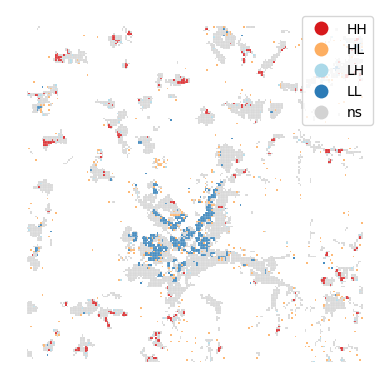

In [112]:
from splot.esda import lisa_cluster, moran_scatterplot

_ = lisa_cluster(lisa, gdf_01)

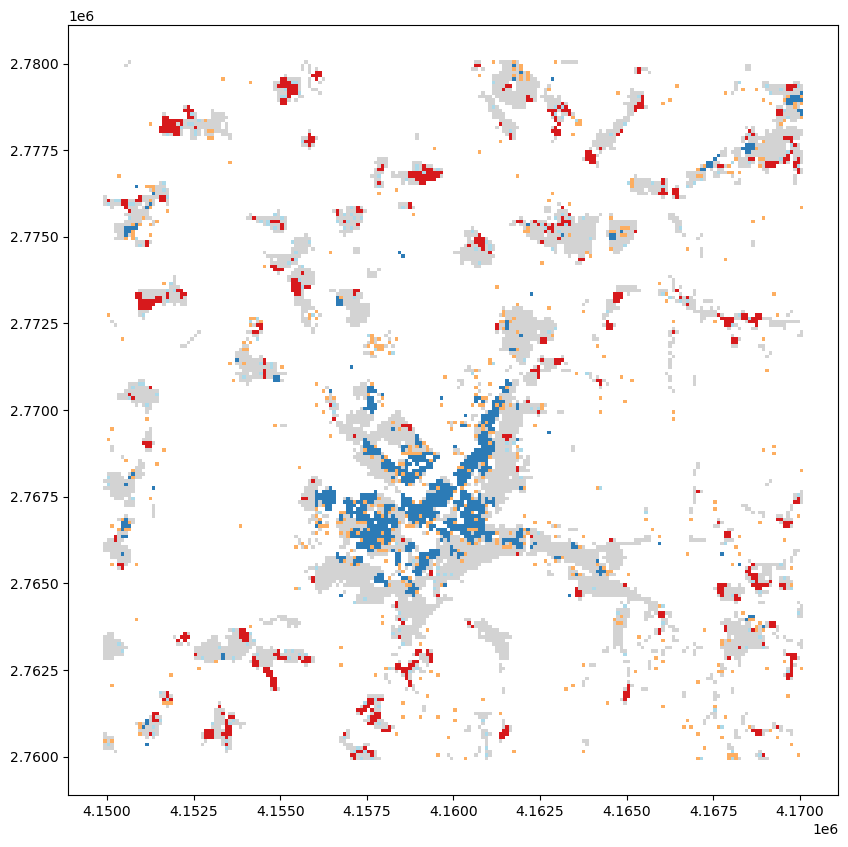

In [113]:
f, ax = plt.subplots(1, figsize=(10, 10))
gdf_01.loc[gdf_01["cluster"] == "Not significant"].plot(ax=ax, color="lightgrey")
gdf_01.loc[(gdf_01["cluster"] == "High-high")].plot(ax=ax, color="#d7191c")
gdf_01.loc[(gdf_01["cluster"] == "Low-low")].plot(ax=ax, color="#2c7bb6")
gdf_01.loc[(gdf_01["cluster"] == "Low-high")].plot(ax=ax, color="#abd9e9")
gdf_01.loc[(gdf_01["cluster"] == "High-low")].plot(ax=ax, color="#fdae61");

In [114]:
gdf_01.explore("cluster", prefer_canvas=True, cmap=["#d7191c","#fdae61","#abd9e9","#2c7bb6","lightgrey"])

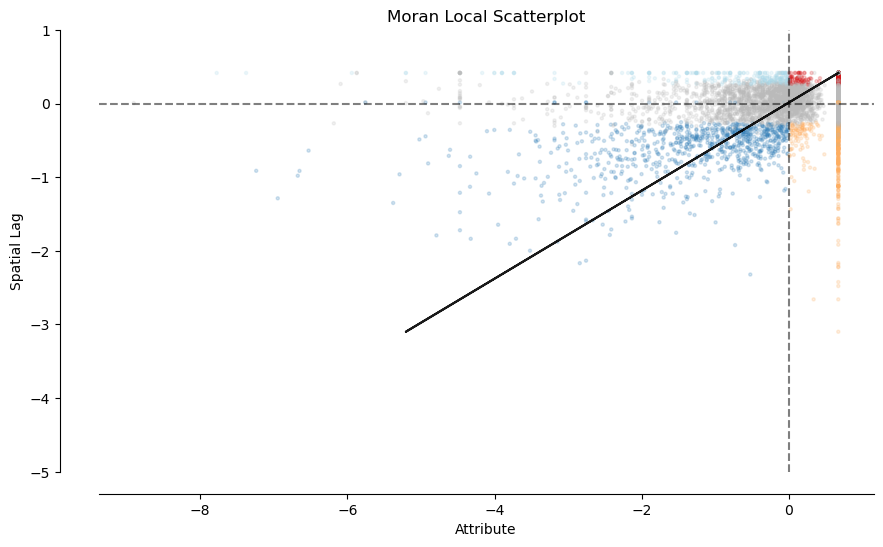

In [115]:
f, ax = plt.subplots(1, figsize=(10, 10))

moran_scatterplot(lisa, p=0.1, scatter_kwds={"s": 5, "alpha":.2},ax = ax)
plt.ylim(-5,1)
plt.show()

## 0.05 Significance

In [116]:
gdf_005 = gdf.copy()

gdf_005.loc[lisa.p_sim < 0.05, 'cluster'] = lisa.q[lisa.p_sim < 0.05]
gdf_005["cluster"] = gdf_005["cluster"].fillna(0)
gdf_005["cluster"] = gdf_005["cluster"].map(
    {
        0: "Not significant",
        1: "High-high",
        2: "Low-high",
        3: "Low-low",
        4: "High-low",
    }
)
gdf_005.head()

Category,Germany,Abroad,geometry,% German,lag,%G_std,%G_std_lag,cluster
ID,,,,,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000,100.000000,0.669586,0.669586,Not significant
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000,100.000000,0.669586,0.669586,High-high
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000,96.744186,0.669586,0.334962,Not significant
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930,98.285714,-1.003532,0.493396,Not significant
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571,96.744186,-0.211362,0.334962,Not significant


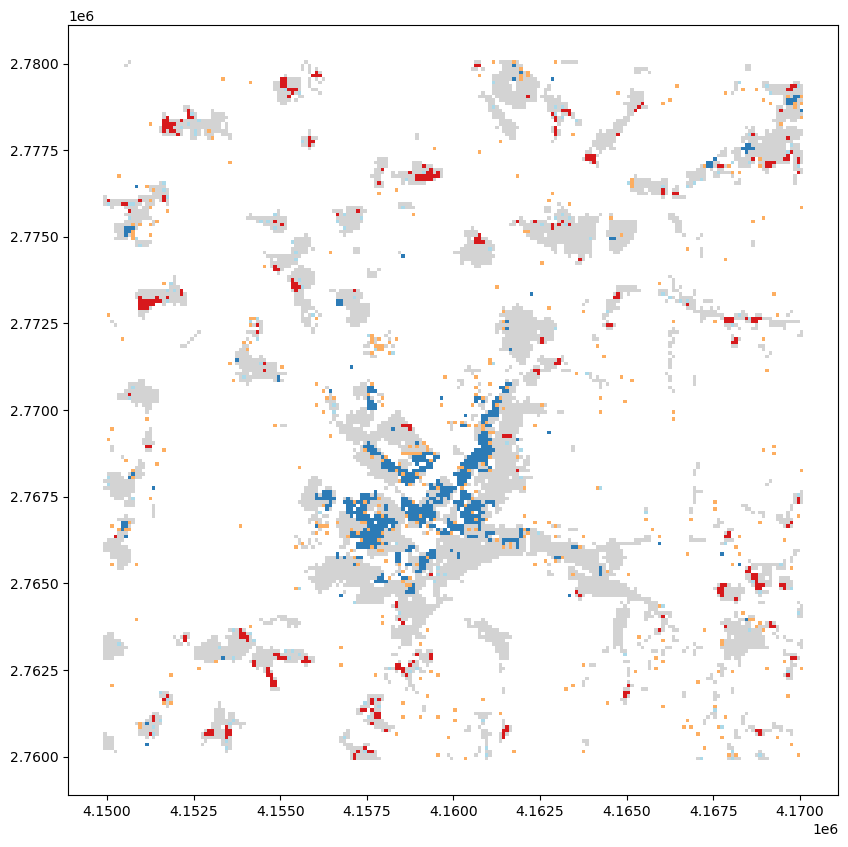

In [117]:
f, ax = plt.subplots(1, figsize=(10, 10))
gdf_005.loc[gdf_005["cluster"] == "Not significant"].plot(ax=ax, color="lightgrey")
gdf_005.loc[(gdf_005["cluster"] == "High-high")].plot(ax=ax, color="#d7191c")
gdf_005.loc[(gdf_005["cluster"] == "Low-low")].plot(ax=ax, color="#2c7bb6")
gdf_005.loc[(gdf_005["cluster"] == "Low-high")].plot(ax=ax, color="#abd9e9")
gdf_005.loc[(gdf_005["cluster"] == "High-low")].plot(ax=ax, color="#fdae61");

In [118]:
gdf_005.explore("cluster", prefer_canvas=True, cmap=["#d7191c","#fdae61","#abd9e9","#2c7bb6","lightgrey"])

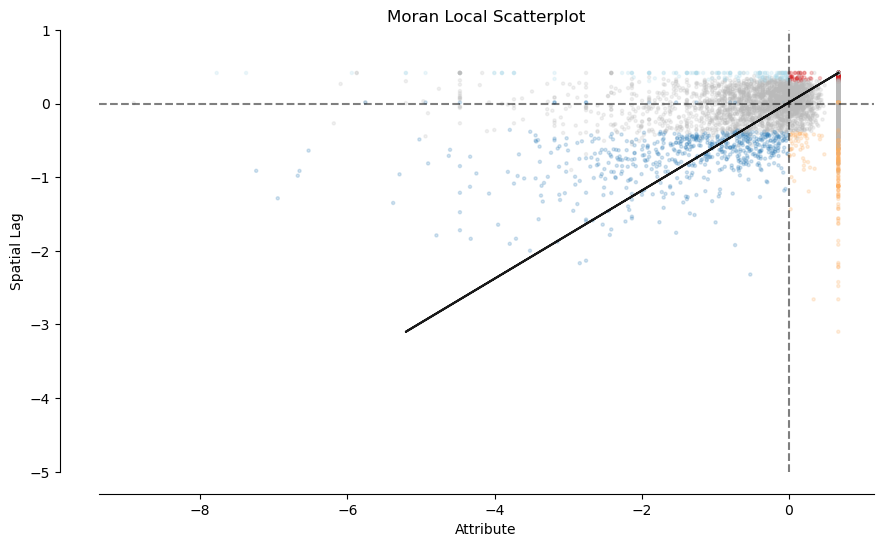

In [119]:
f, ax = plt.subplots(1, figsize=(10, 10))

moran_scatterplot(lisa, p=0.05, scatter_kwds={"s": 5, "alpha":.2},ax = ax)
plt.ylim(-5,1)
plt.show()

## 0.01 Significance

In [120]:
gdf_001 = gdf.copy()

gdf_001.loc[lisa.p_sim < 0.01, 'cluster'] = lisa.q[lisa.p_sim < 0.01]
gdf_001["cluster"] = gdf_001["cluster"].fillna(0)
gdf_001["cluster"] = gdf_001["cluster"].map(
    {
        0: "Not significant",
        1: "High-high",
        2: "Low-high",
        3: "Low-low",
        4: "High-low",
    }
)
gdf_001.head()

Category,Germany,Abroad,geometry,% German,lag,%G_std,%G_std_lag,cluster
ID,,,,,,,,
100mN27599E41570,12.0,NaN,"POLYGON ((4157100 2760000, 4157100 2759900, 41...",100.000000,100.000000,0.669586,0.669586,Not significant
100mN27599E41571,16.0,NaN,"POLYGON ((4157200 2760000, 4157200 2759900, 41...",100.000000,100.000000,0.669586,0.669586,High-high
100mN27599E41572,23.0,NaN,"POLYGON ((4157300 2760000, 4157300 2759900, 41...",100.000000,96.744186,0.669586,0.334962,Not significant
100mN27599E41573,72.0,14.0,"POLYGON ((4157400 2760000, 4157400 2759900, 41...",83.720930,98.285714,-1.003532,0.493396,Not significant
100mN27599E41574,32.0,3.0,"POLYGON ((4157500 2760000, 4157500 2759900, 41...",91.428571,96.744186,-0.211362,0.334962,Not significant


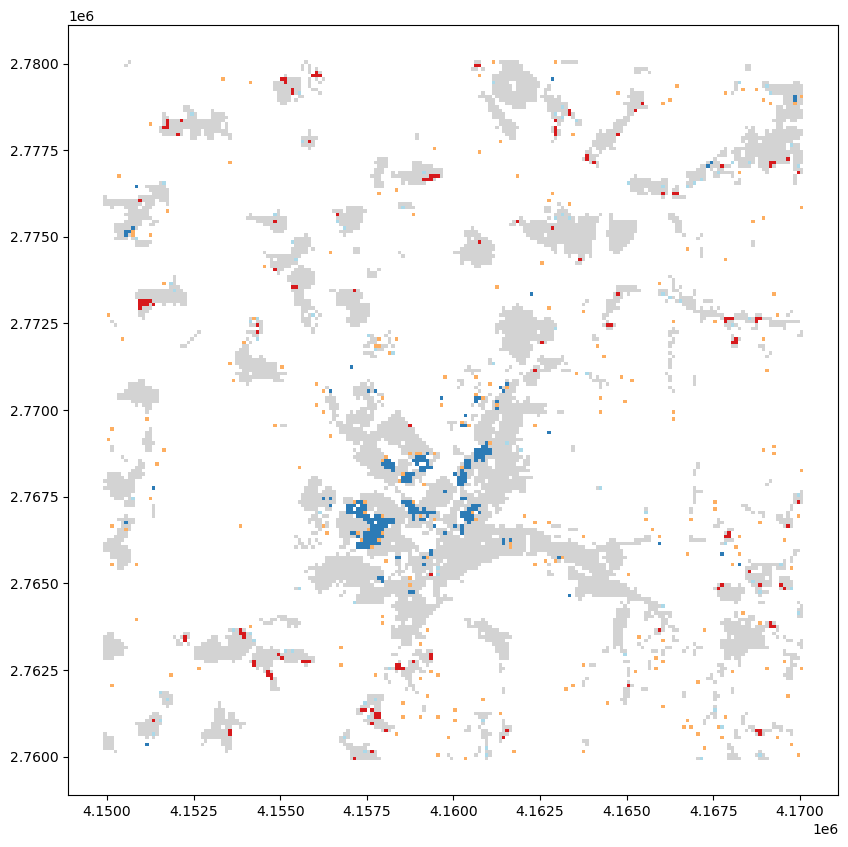

In [121]:
f, ax = plt.subplots(1, figsize=(10, 10))
gdf_001.loc[gdf_001["cluster"] == "Not significant"].plot(ax=ax, color="lightgrey")
gdf_001.loc[(gdf_001["cluster"] == "High-high")].plot(ax=ax, color="#d7191c")
gdf_001.loc[(gdf_001["cluster"] == "Low-low")].plot(ax=ax, color="#2c7bb6")
gdf_001.loc[(gdf_001["cluster"] == "Low-high")].plot(ax=ax, color="#abd9e9")
gdf_001.loc[(gdf_001["cluster"] == "High-low")].plot(ax=ax, color="#fdae61");

In [122]:
gdf_001.explore("cluster", prefer_canvas=True, cmap=["#d7191c","#fdae61","#abd9e9","#2c7bb6","lightgrey"])

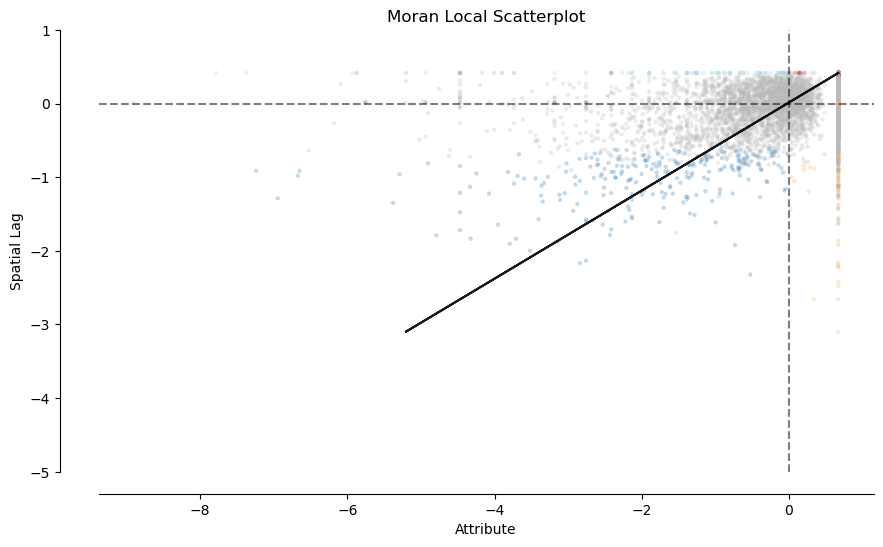

In [123]:
f, ax = plt.subplots(1, figsize=(10, 10))

moran_scatterplot(lisa, p=0.01, scatter_kwds={"s": 5, "alpha":.2},ax = ax)
plt.ylim(-5,1)
plt.show()

In [129]:
import folium

In [132]:
m = gdf_001.explore("cluster", prefer_canvas=True, cmap=["#d7191c","#fdae61","#abd9e9","#2c7bb6","lightgrey"],style_kwds={'fillOpacity': 0.3, 'weight': 0}, name = "0.01")

gdf_005.explore("cluster", prefer_canvas=True, cmap=["#d7191c","#fdae61","#abd9e9","#2c7bb6","lightgrey"],style_kwds={'fillOpacity': 0.3, 'weight': 0}, name = "0.05",m=m)

gdf_01.explore("cluster", prefer_canvas=True, cmap=["#d7191c","#fdae61","#abd9e9","#2c7bb6","lightgrey"],style_kwds={'fillOpacity': 0.3, 'weight': 0}, name = "0.1",m=m)

# Add a layer control to toggle the layers on and off
folium.LayerControl().add_to(m)

# Display the map
m